Code for **super-resolution** (figures $1$ and $5$ from main paper).. Change `factor` to $8$ to reproduce images from fig. $9$ from supmat.

You can play with parameters and see how they affect the result. 

# Import libs

In [1]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import argparse
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '3'

import numpy as np
from models import *
from models.skip_intrinsic import SkipIntrinsic

import torch
import torch.optim

from skimage.measure import compare_psnr, compare_ssim, compare_nrmse
from models.downsampler import Downsampler
from torchsummary import summary

from utils.sr_utils import *
from PIL import Image

torch.manual_seed(123)
np.random.seed(123)
torch.backends.cudnn.enabled = True
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

dtype = torch.cuda.FloatTensor

imsize = -1 
factor = 2
enforse_div32 = 'CROP' # Already divisible by 32
PLOT = True

path_to_image = 'data/gif/giphy.gif'

# Load image and baselines

49


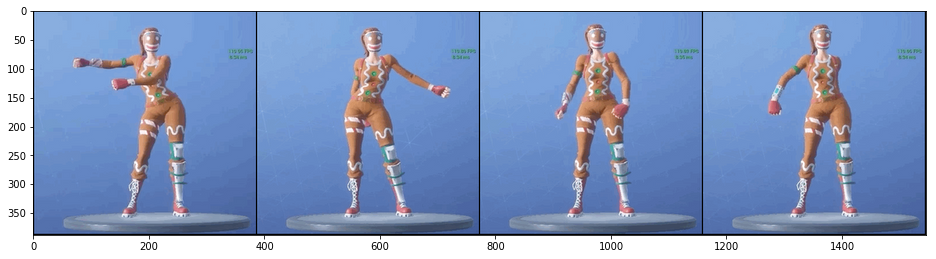

384 384


In [2]:
imgs_pil, imgs_np = read_gif(path_to_image)
print(len(imgs_np))

if PLOT:
    plot_image_grid([imgs_np[0], imgs_np[10], imgs_np[20], imgs_np[30]], 4, 12);

_, H, W = imgs_np[0].shape
print(H, W)
# target_image_np = imgs['HR_np']
# target_image_pil = imgs['HR_pil']
# target_image_pil.save('data/sr/zebra_lr.png')

# im = Image.open(path_to_image)
# print(im.palette)
# for frame in ImageSequence.Iterator(im):
#     img_np = np.array(frame)
#     img_pil = Image.fromarray(img_np)
#     img_pil.putpalette(im.getpalette())
#     img_rgb = img_pil.convert('RGB')
#     img_rgb_np = np.array(img_rgb)
#     plt.imshow(img_rgb_np)
#     print(img_rgb_np.shape)

# Set up parameters and net

In [3]:
input_depth = 32
 
INPUT =     'noise'
pad   =     'reflection'
OPT_OVER =  'net'
KERNEL_TYPE='lanczos2'

tv_weight = 0.0

OPTIMIZER = 'adam'

num_iter = 10000
d = 5000

In [4]:
net_input = get_noise(input_depth, INPUT, (H, W)).type(dtype).detach()

net = SkipIntrinsic(num_input_channels=input_depth,
           num_output_channels=3,
           num_channels_down = [16, 32, 64, 128, 128],
           num_channels_up = [16, 32, 64, 128, 128],
           num_channels_skip = [4]*5,
           upsample_mode='bilinear',
           downsample_mode='stride',
           need_sigmoid=True,
           need_bias=True,
           pad=pad,
           act_fun='LeakyReLU',
           d=d).type(dtype)

net = net.cuda()
orig_dict = net.state_dict()

# Losses
mse = torch.nn.MSELoss().type(dtype)

1041815
0


# Define closure and optimize

In [5]:
# print(net.bn1_1)

In [6]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

def closure(x):
    global j, net_input, max_psnr, best_subspace
    
    out_HR = net(net_input, x)

    total_loss = mse(out_HR, img_HR_var)
        
    total_loss.backward()

    # Log
    psnr_HR = compare_psnr(target_image_np, torch_to_np(out_HR))
    if psnr_HR > max_psnr:
        max_psnr = psnr_HR
        best_subspace = x.clone()
    print ('Iteration %05d PSNR_HR %.3f Loss %.4f' % (j, psnr_HR, total_loss.data), '\r', end='')
                      
    # History
    psnr_history.append([psnr_HR])
    
    if PLOT and j % 500 == 0:
        out_HR_np = torch_to_np(out_HR)
        plot_image_grid([target_image_np, np.clip(out_HR_np, 0, 1)], factor=4, nrow=2)
    
    return total_loss, psnr_HR

/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2351: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2423: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


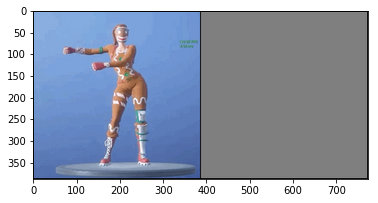

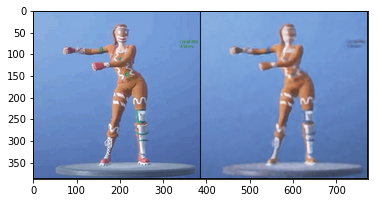

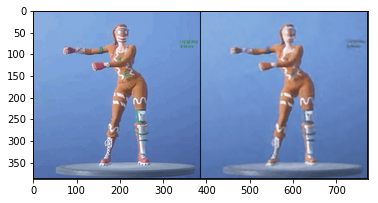

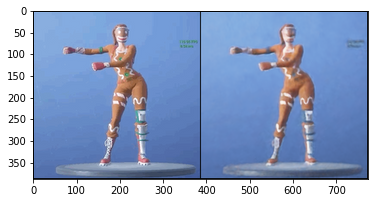

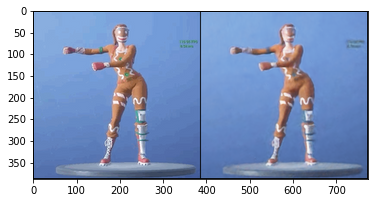

...

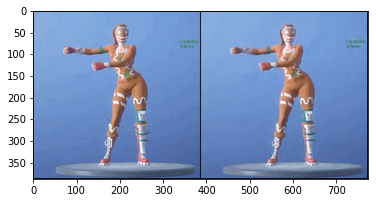

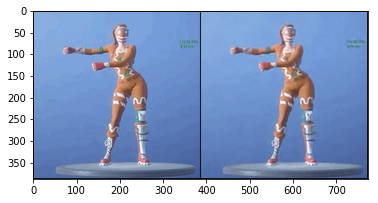

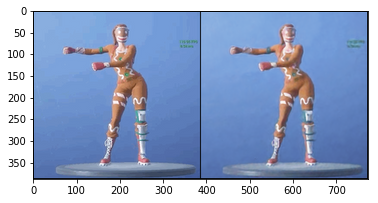

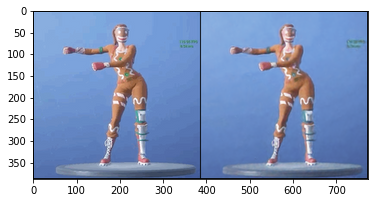

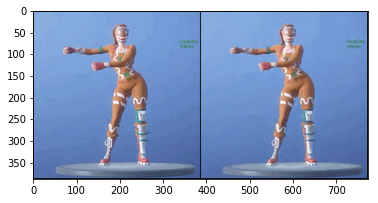

34.57091627805267SNR_HR 33.928 Loss 0.0004 


In [7]:
index = 0
target_image_np = imgs_np[index]
img_HR_var = np_to_torch(target_image_np).type(dtype)

subspace = np_to_torch(np.zeros((d), dtype=np.float32)).type(dtype)
subspace = torch.transpose(subspace, 0, 1)
subspace.requires_grad=True

psnr_history = [] 
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()


i=0
LR = 0.04
max_psnr = 0
best_subspace = subspace
optimizer = torch.optim.Adam([subspace], lr=LR)
for j in range(num_iter):
    optimizer.zero_grad()
    closure(subspace)
    optimizer.step()

print(max_psnr)

In [12]:
print(max_psnr)
out = net(net_input, subspace)
psnr_HR = compare_psnr(target_image_np, torch_to_np(out))
print(psnr_HR)

out = net(net_input, best_subspace)
psnr_HR = compare_psnr(target_image_np, torch_to_np(out))
print(psnr_HR)

subspace = best_subspace

34.57091627805267
33.82817045775668
34.570919444784984


/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2351: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2423: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2351: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2423: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


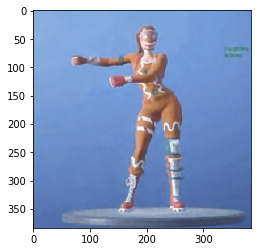

In [13]:
subspace_list = [None] * len(imgs_np)
subspace_list_np = [None] * (len(imgs_np))
diff_list = [None] * (len(imgs_np) - 1)
img_list = [None] * len(imgs_np)
subspace_list[0] = subspace
subspace_list_np[0] = subspace.detach().cpu().numpy()

out = net(net_input, subspace)
out_np = np.clip(np.transpose(torch_to_np(out), (1, 2, 0)), 0, 1)
plt.imshow(out_np)
img_list.append(out_np)

subspace_name = 'floss_subspace_0.npy'
img_name = 'floss_img_0.npy'

np.save(subspace_name, np.array(subspace_list_np))
np.save(img_name, out_np)


Image:  1


/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2351: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2423: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


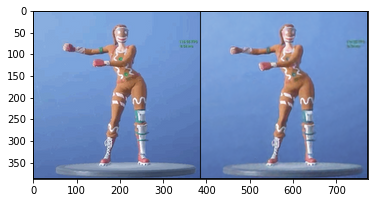

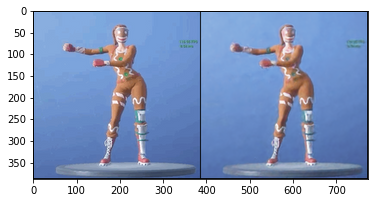

Subspace number:  0R_HR 34.006 Loss 0.0004 
Subspace list length:  49
Image:  2


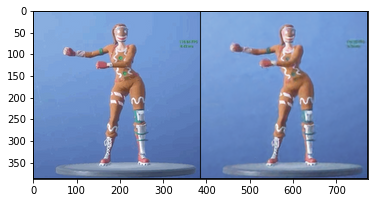

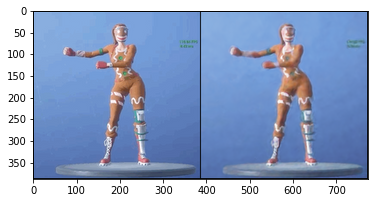

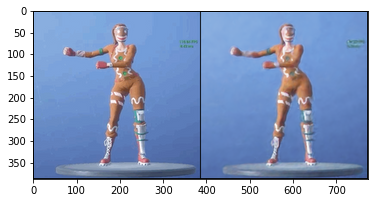

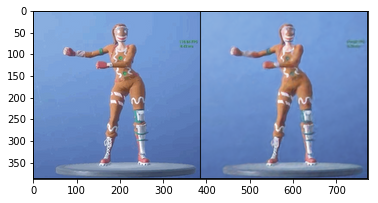

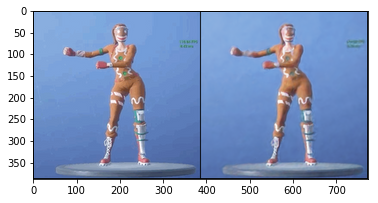

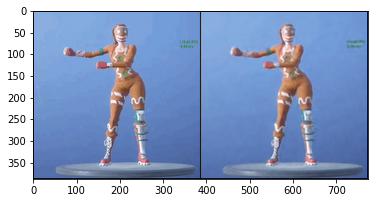

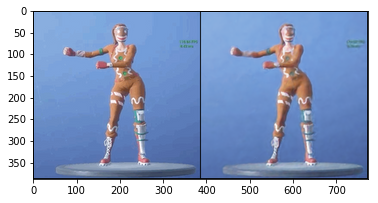

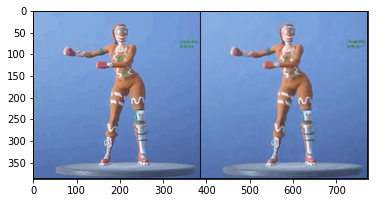

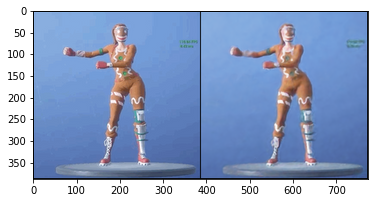

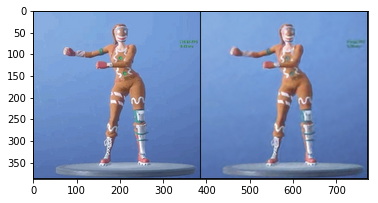

Subspace number:  1R_HR 33.640 Loss 0.0004 
Subspace list length:  49
Image:  3


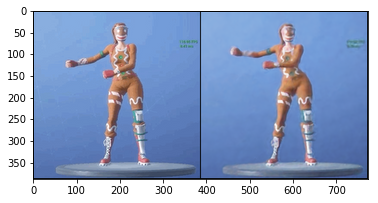

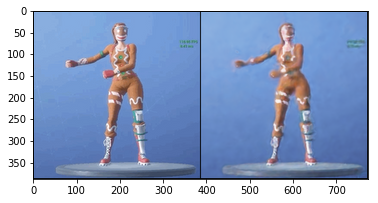

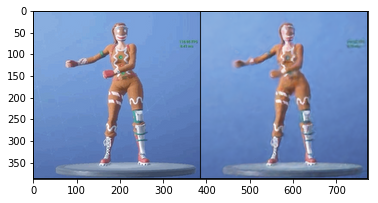

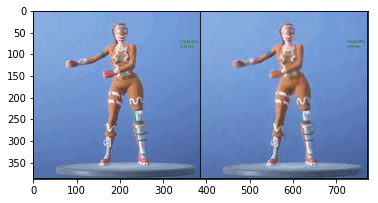

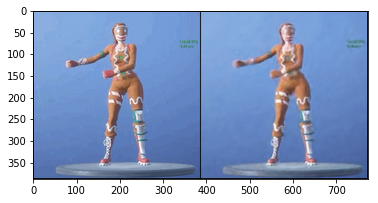

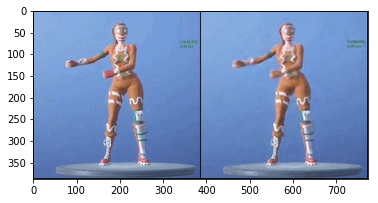

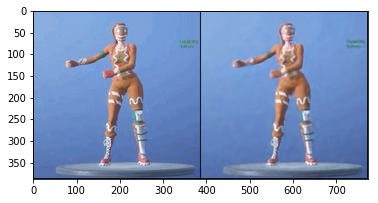

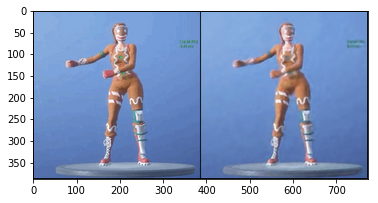

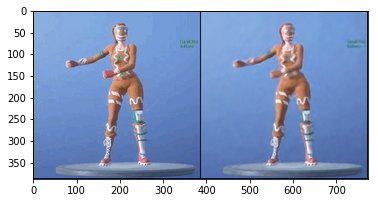

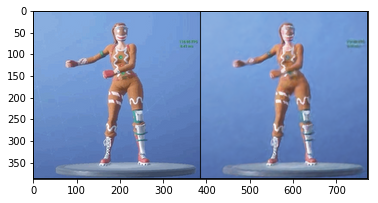

Subspace number:  2R_HR 32.745 Loss 0.0005 
Subspace list length:  49
Image:  4


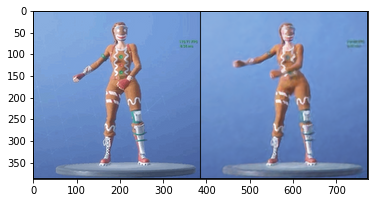

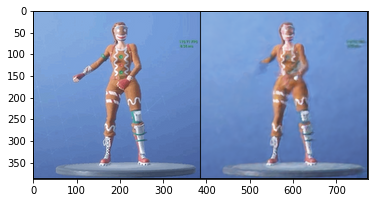

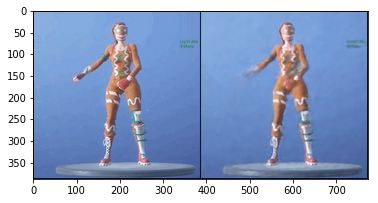

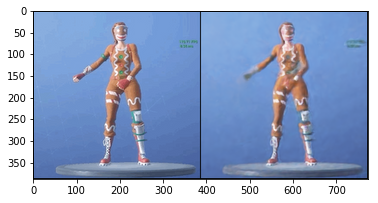

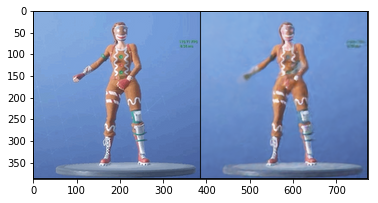

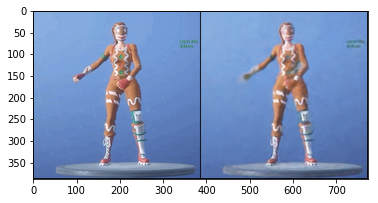

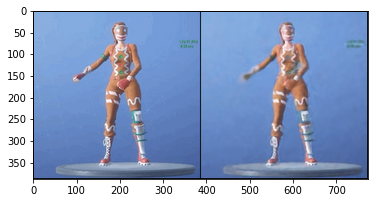

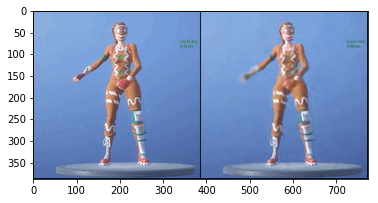

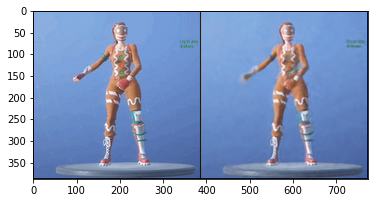

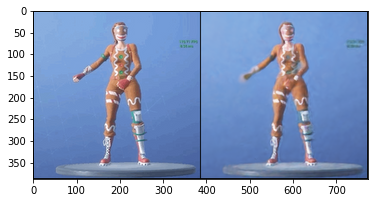

Subspace number:  3R_HR 31.971 Loss 0.0006 
Subspace list length:  49
Image:  5


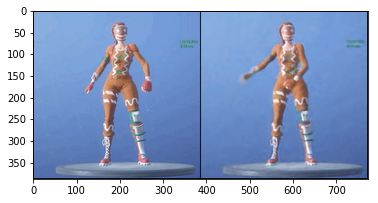

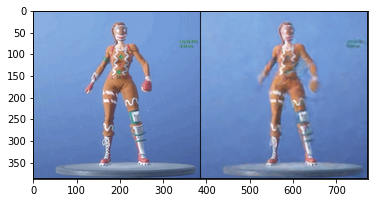

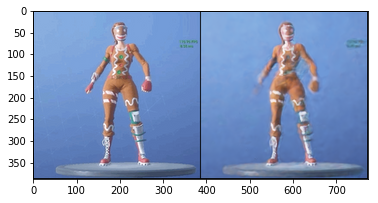

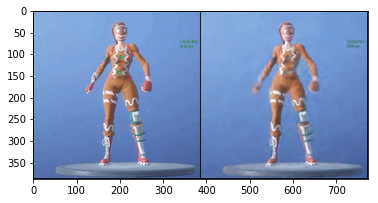

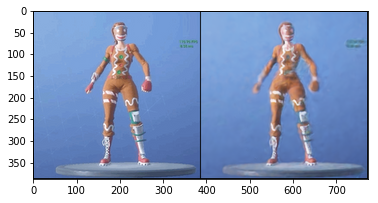

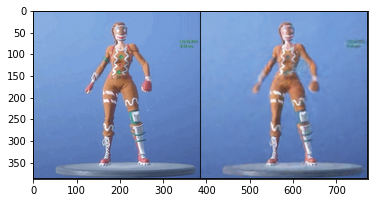

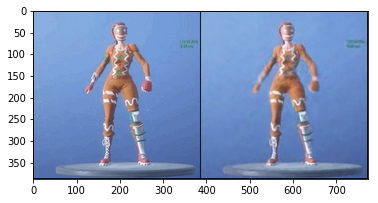

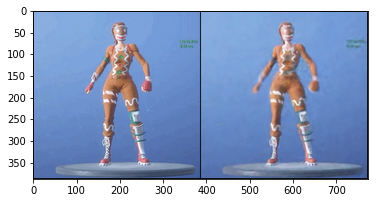

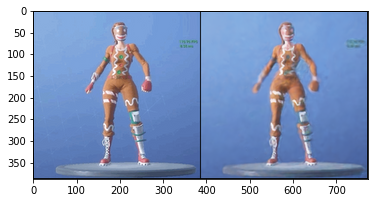

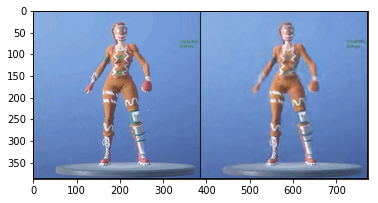

Subspace number:  4R_HR 31.972 Loss 0.0006 
Subspace list length:  49
Image:  6


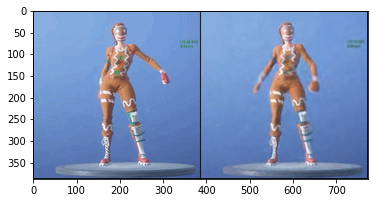

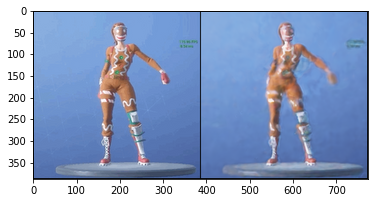

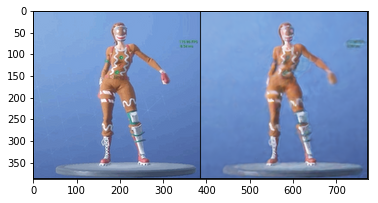

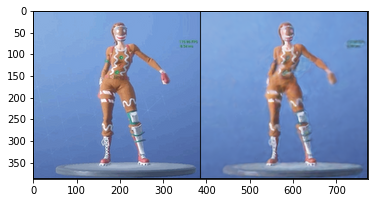

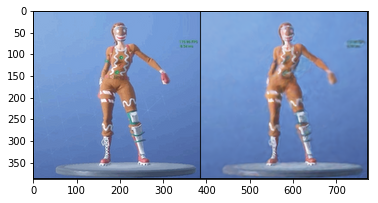

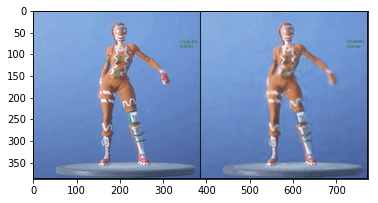

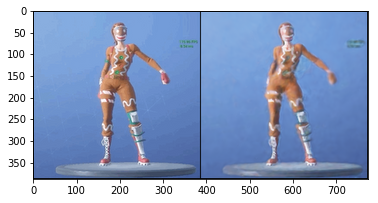

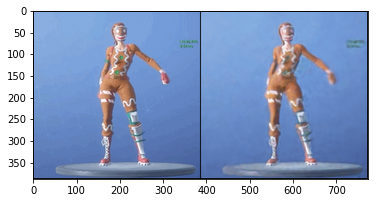

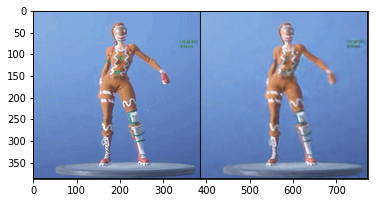

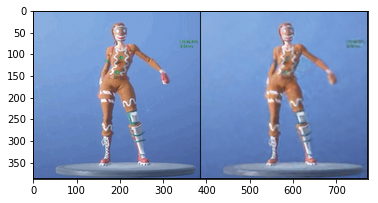

Subspace number:  5R_HR 31.980 Loss 0.0006 
Subspace list length:  49
Image:  7


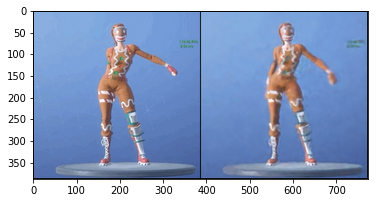

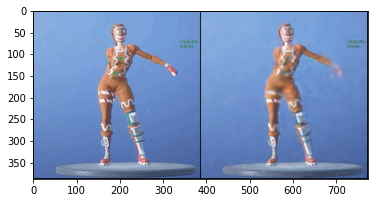

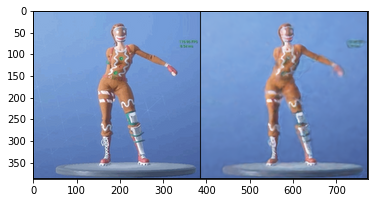

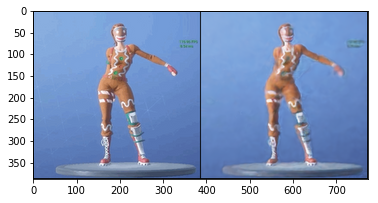

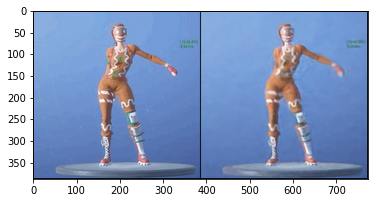

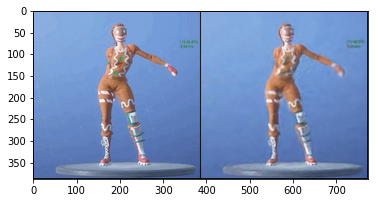

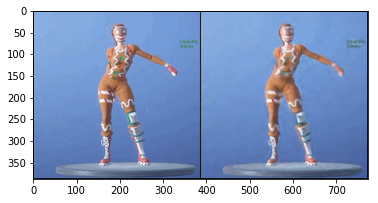

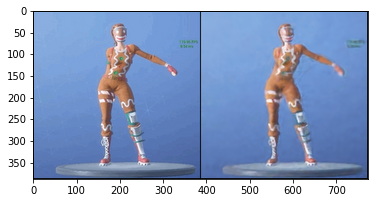

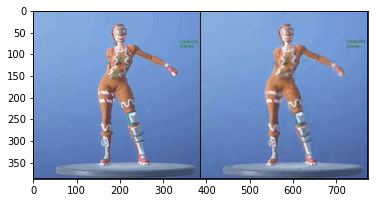

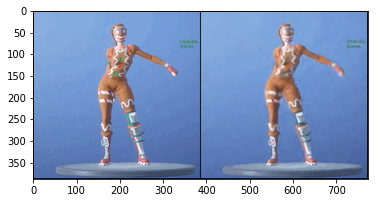

Subspace number:  6R_HR 32.223 Loss 0.0006 
Subspace list length:  49
Image:  8


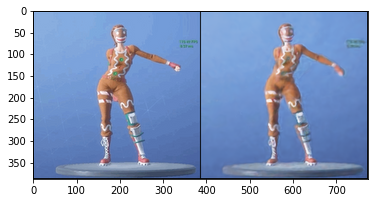

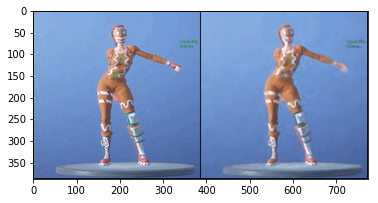

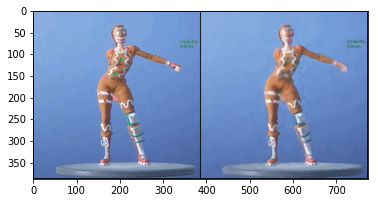

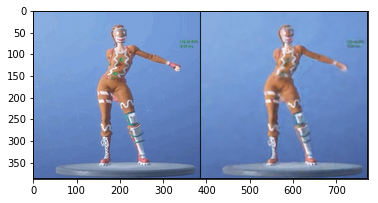

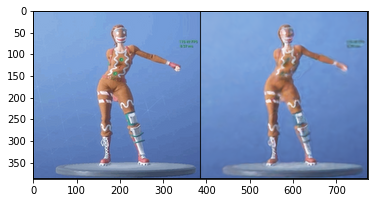

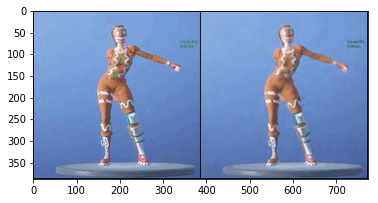

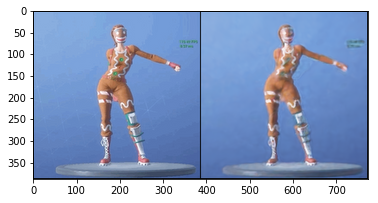

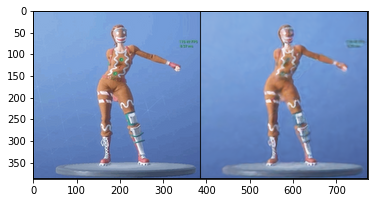

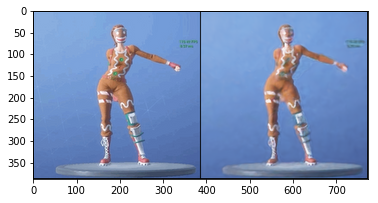

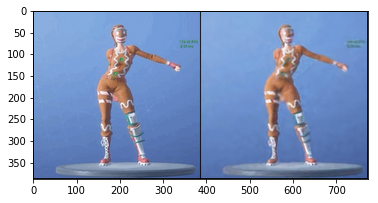

Subspace number:  7R_HR 32.628 Loss 0.0005 
Subspace list length:  49
Image:  9


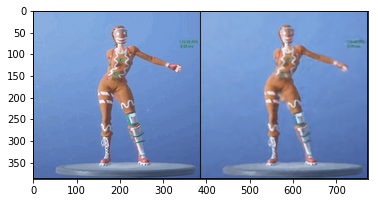

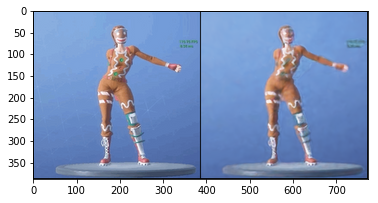

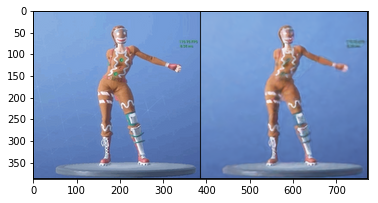

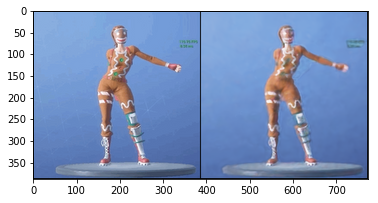

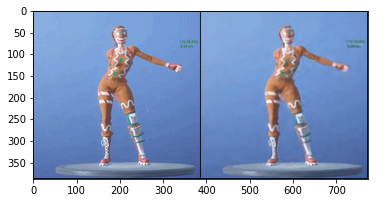

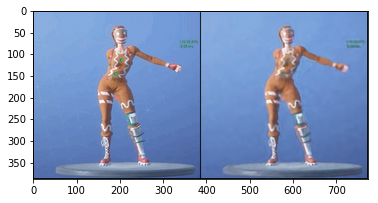

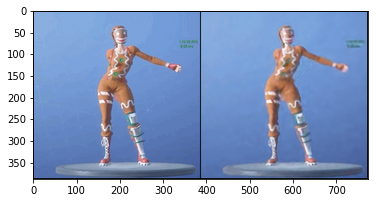

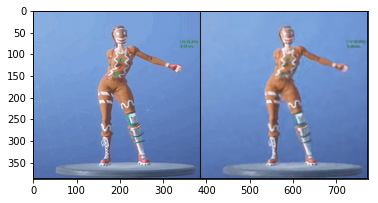

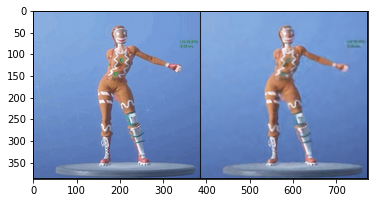

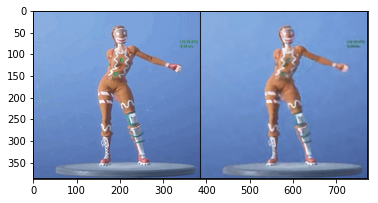

Subspace number:  8R_HR 32.663 Loss 0.0005 
Subspace list length:  49
Image:  10


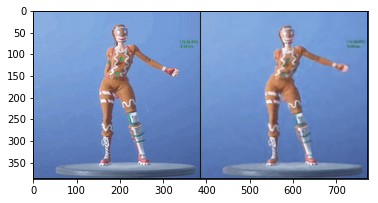

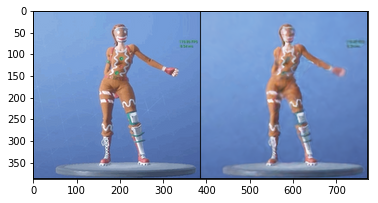

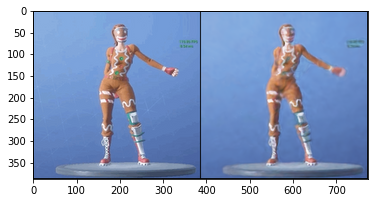

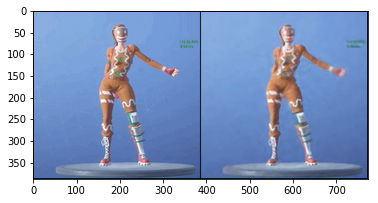

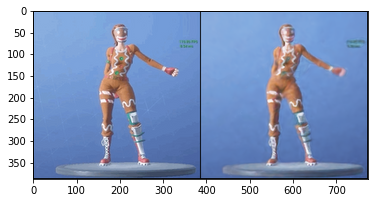

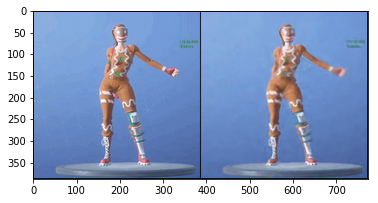

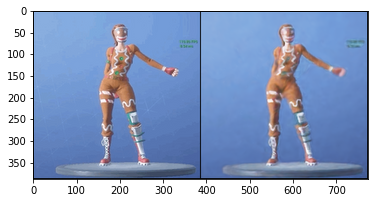

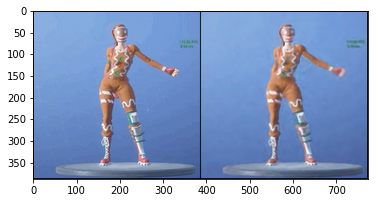

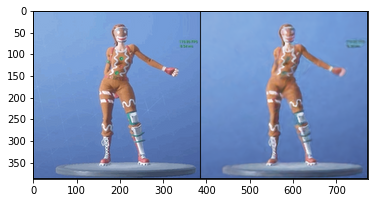

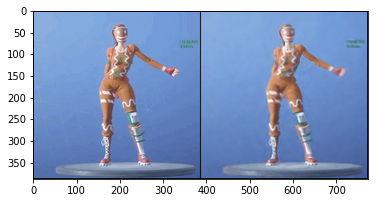

Subspace number:  9R_HR 32.677 Loss 0.0005 
Subspace list length:  49
Image:  11


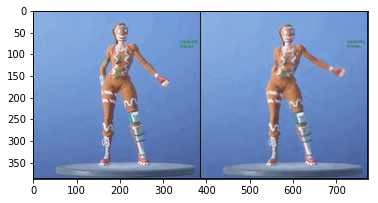

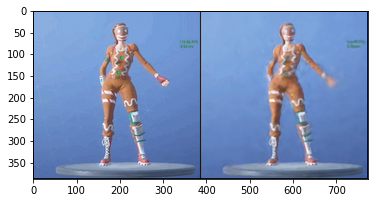

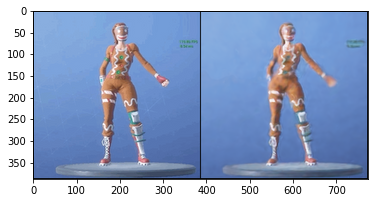

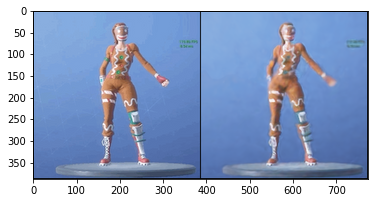

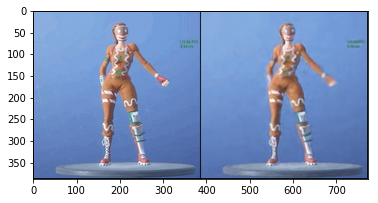

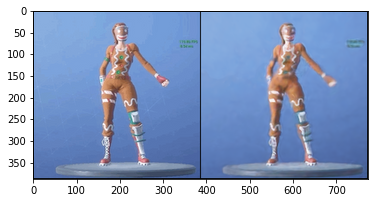

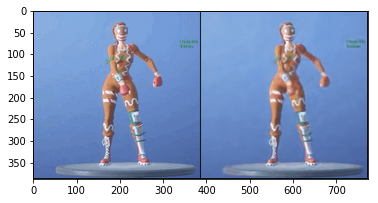

Subspace number:  36_HR 32.292 Loss 0.0006 
Subspace list length:  49
Image:  38


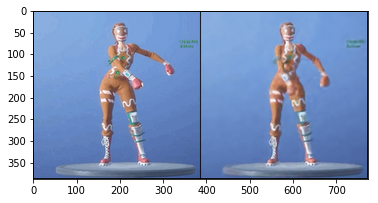

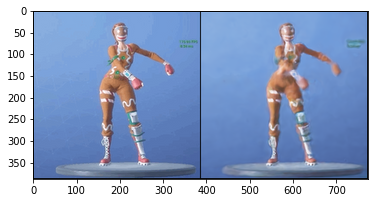

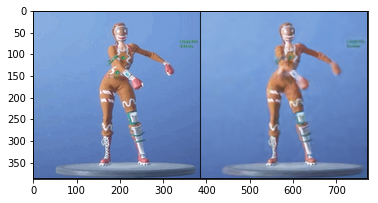

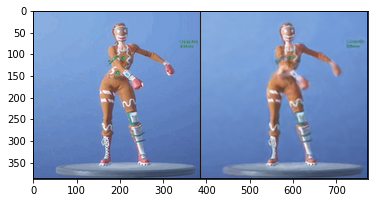

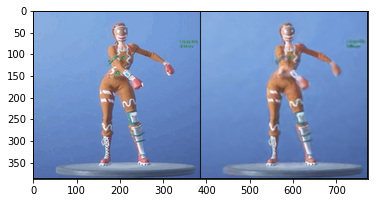

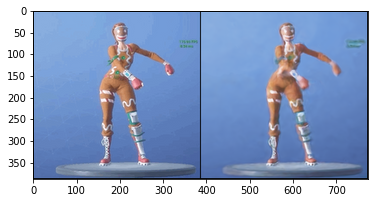

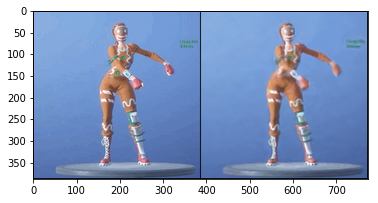

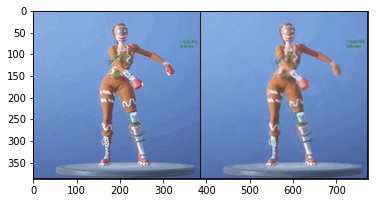

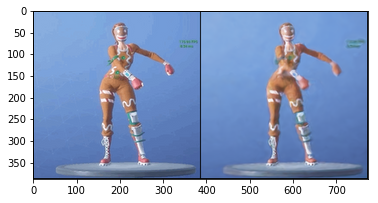

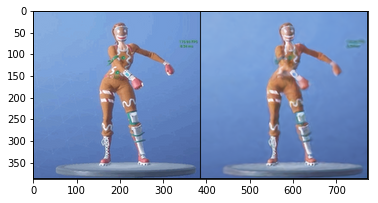

Subspace number:  37_HR 32.286 Loss 0.0006 
Subspace list length:  49
Image:  39


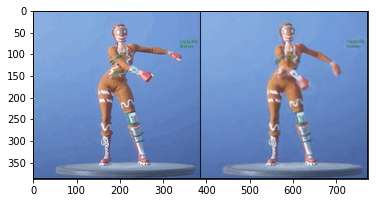

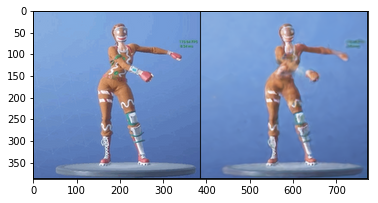

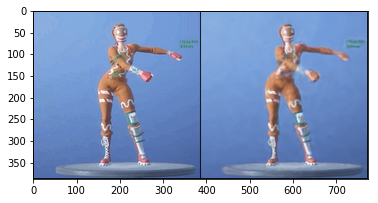

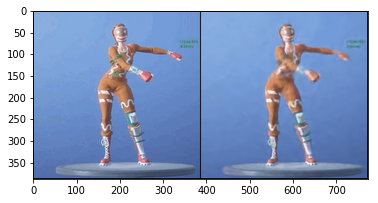

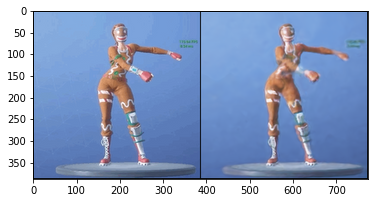

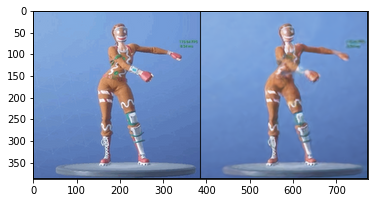

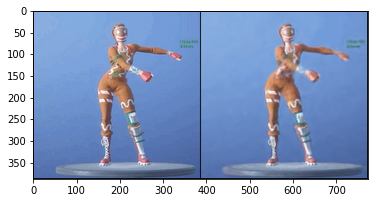

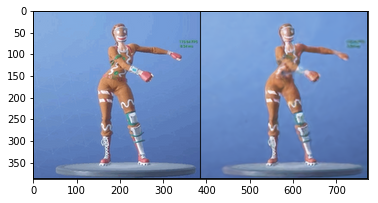

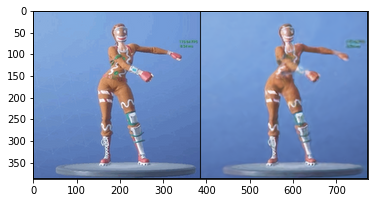

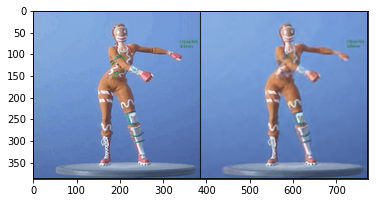

Subspace number:  38_HR 32.497 Loss 0.0006 
Subspace list length:  49
Image:  40


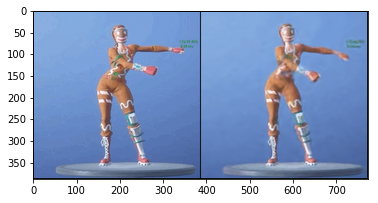

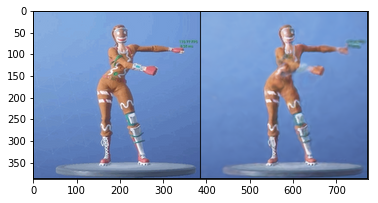

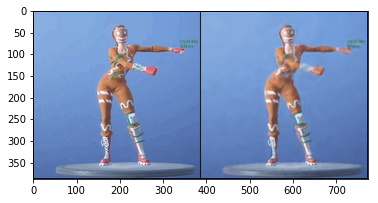

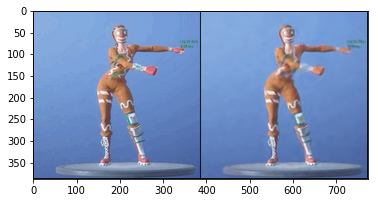

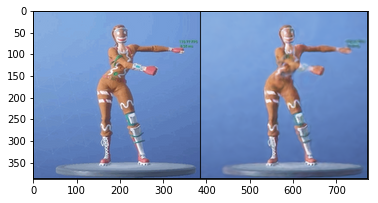

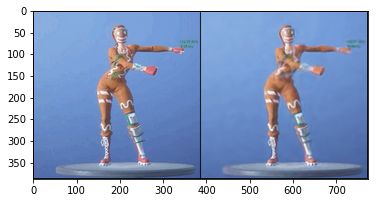

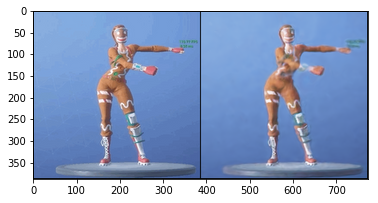

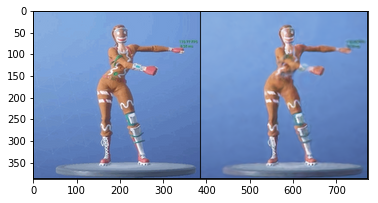

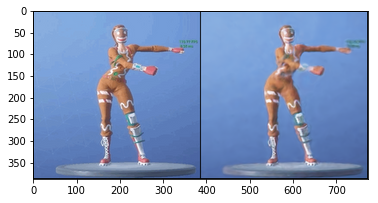

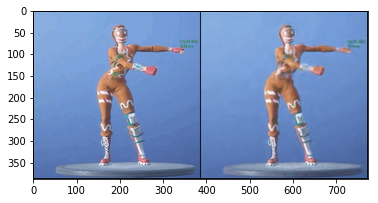

Subspace number:  39_HR 32.586 Loss 0.0006 
Subspace list length:  49
Image:  41


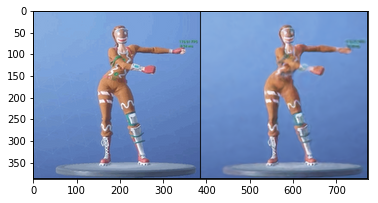

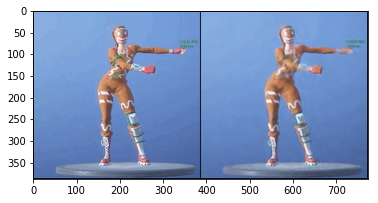

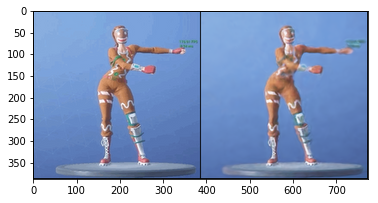

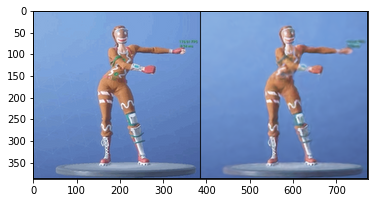

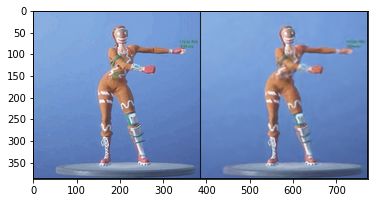

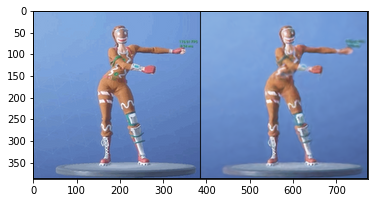

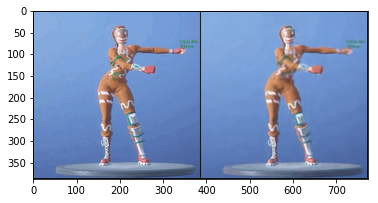

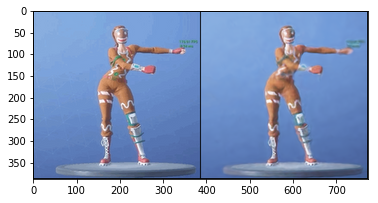

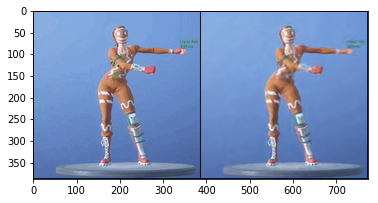

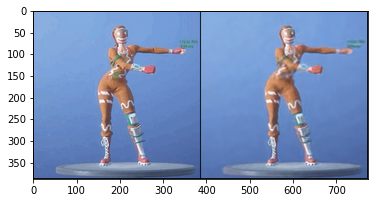

Subspace number:  40_HR 32.475 Loss 0.0006 
Subspace list length:  49
Image:  42


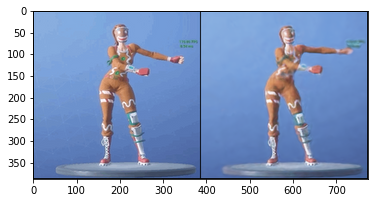

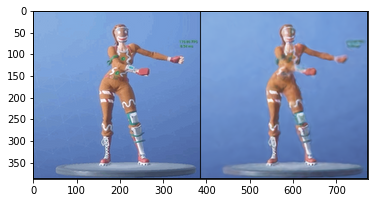

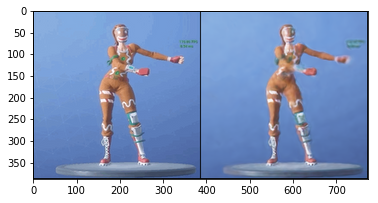

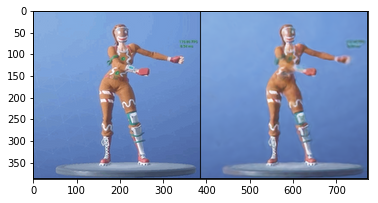

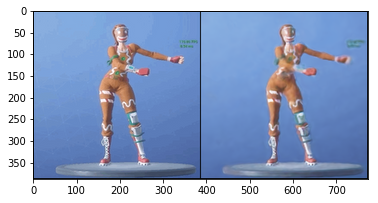

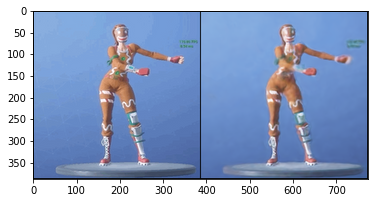

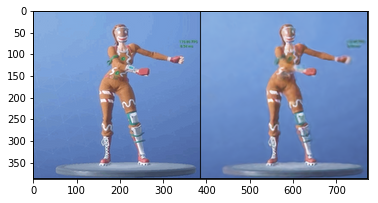

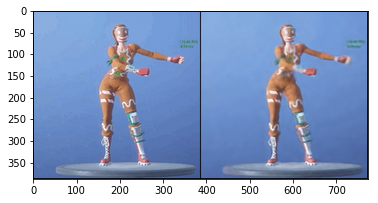

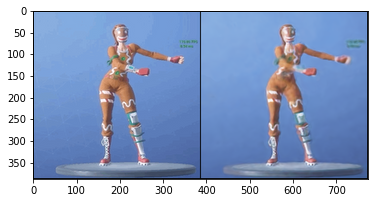

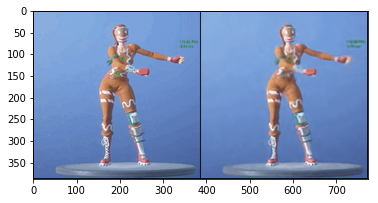

Subspace number:  41_HR 32.876 Loss 0.0005 
Subspace list length:  49
Image:  43


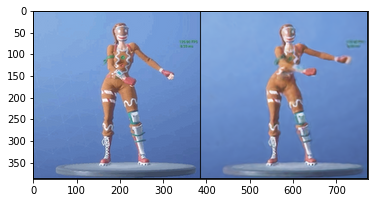

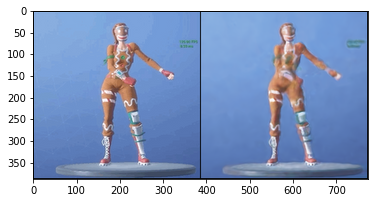

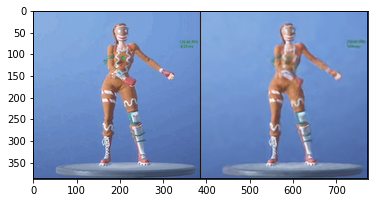

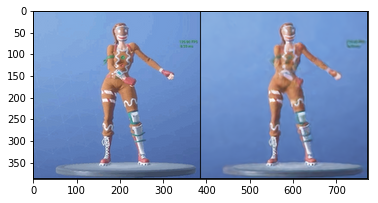

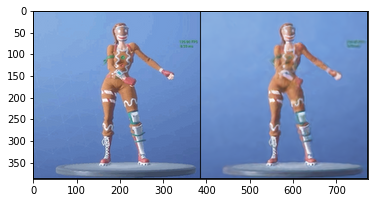

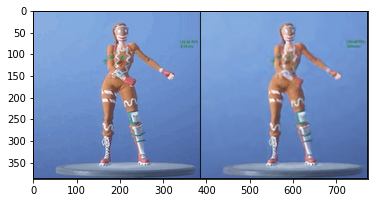

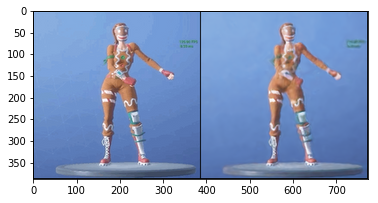

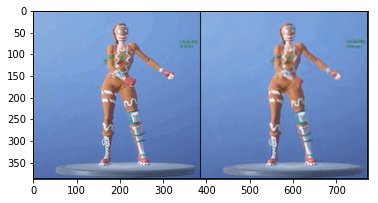

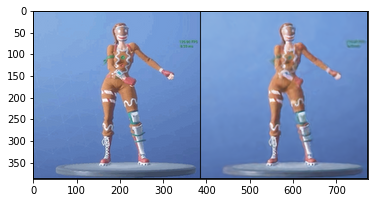

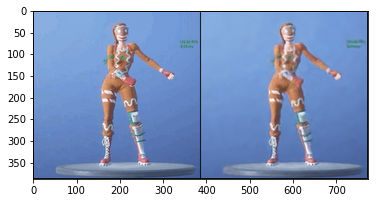

Subspace number:  42_HR 32.777 Loss 0.0005 
Subspace list length:  49
Image:  44


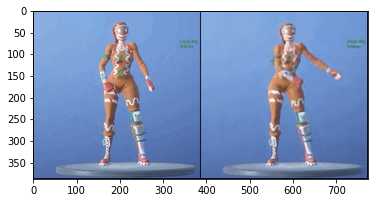

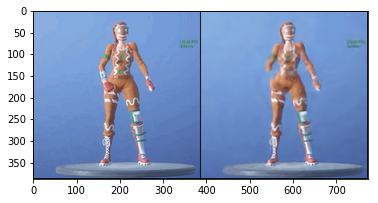

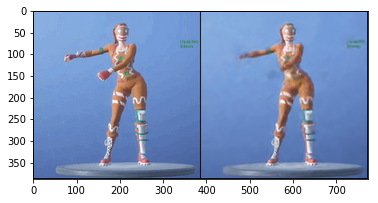

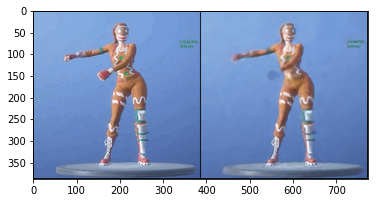

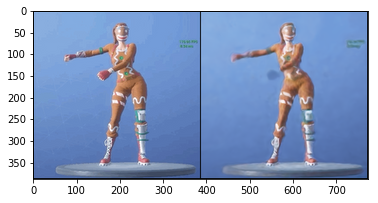

...

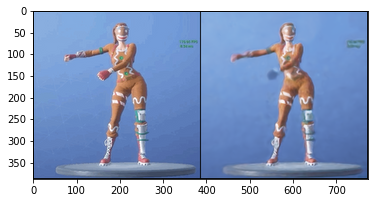

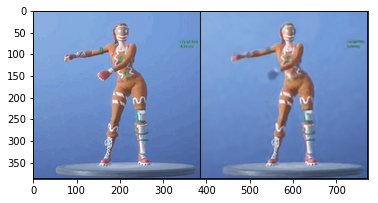

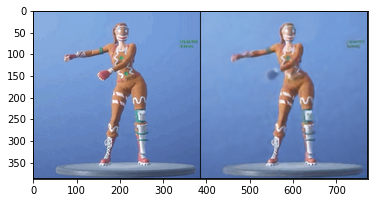

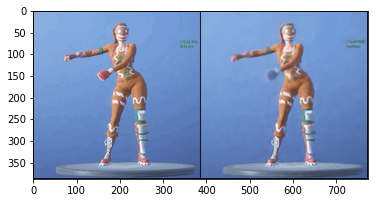

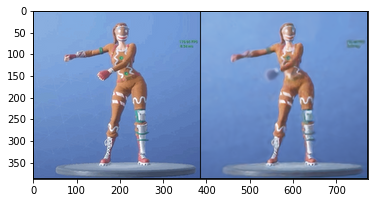

Subspace number:  46_HR 31.500 Loss 0.0007 
Subspace list length:  49
Image:  48


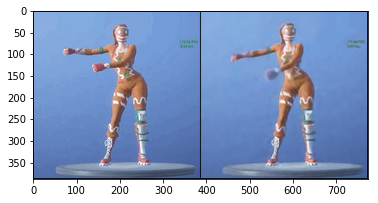

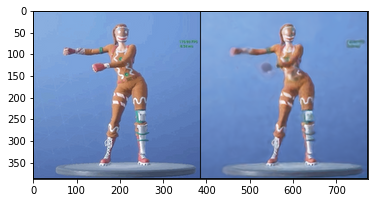

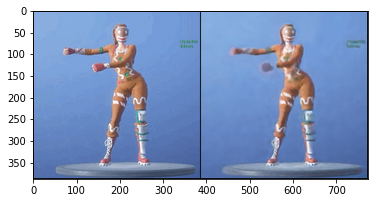

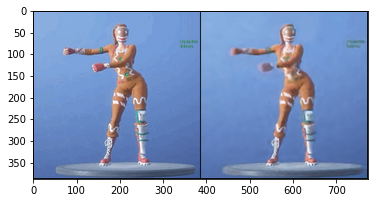

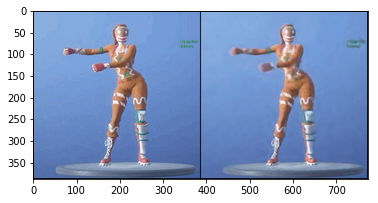

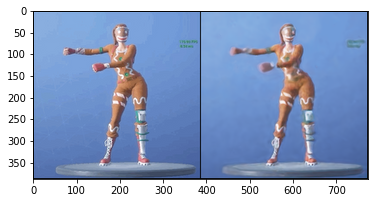

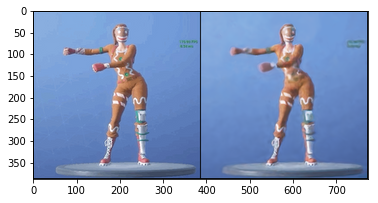

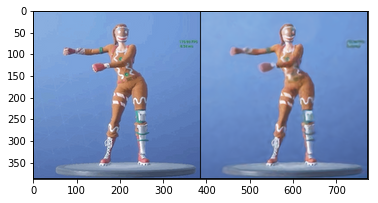

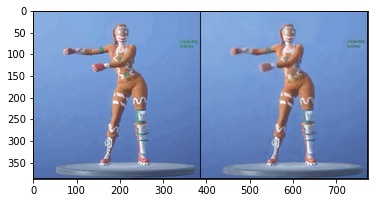

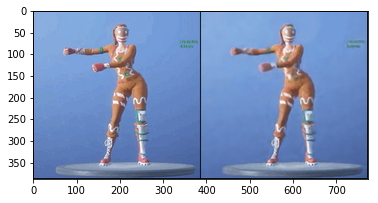

Subspace number:  47_HR 32.469 Loss 0.0006 
Subspace list length:  49


In [ ]:
start = 1
end = len(imgs_np)
scale = 0.02
num_iter = 5000
LR = 0.04
for index in range(start, end):
    target_image_np = imgs_np[index]
    img_HR_var = np_to_torch(target_image_np).type(dtype)
    
    delta = np_to_torch(np.zeros((d), dtype=np.float)).type(dtype)
    delta = torch.transpose(delta, 0, 1)
    delta.requires_grad=True
    
    psnr_history = []
    optimizer = torch.optim.Adam([delta], lr=LR)
    print("Image: ", index)
    stop = False
    for j in range(num_iter):
        optimizer.zero_grad()

        vec = delta.clone().int()
        vec = vec.float()
        vec.requires_grad = True
        
        y = subspace_list[index - 1] + torch.mul(vec.clamp(-8, 7), scale) #4 bit encoding
        loss_val, psnr = closure(y)
        if psnr < 34:
            delta.grad = vec.grad
            optimizer.step()
        else:
            stop = True
        
        if (j == num_iter - 1) or stop:
            vec = delta.clone().int()
            vec = vec.float()
            
            print("Subspace number: ", index - 1)
            subspace_new = subspace_list[index - 1] + torch.mul(vec.clamp(-8, 7), scale)
            out = net(net_input, subspace_new)
            
            out_np = np.transpose(torch_to_np(out), (1, 2, 0))
            subspace_list[index] = subspace_new
            print("Subspace list length: ", len(subspace_list))
            subspace_list_np[index] = subspace_new.detach().cpu().numpy()
            diff_list[index - 1] = vec.clamp(-8, 7).detach().int().cpu().numpy()
            img_list[index] = out_np
            break
    
    subspace_name = 'floss_subspace_' + str(index) + '.npy'
    diff_name = 'floss_diff_' + str(index) + '.npy'
    img_name = 'floss_img_' + str(index) + '.npy'
    np.save(subspace_name, np.array(subspace_list_np))
    np.save(diff_name, np.array(diff_list))
    np.save(img_name, img_list[index])
    

In [ ]:
print(j)
print(len(diff_list))
x = np.array(subspace_list_np)
print(x.shape)
import skimage.io as sio

In [ ]:
im = img_list[1]
print(im.dtype)

In [ ]:
for i in range(1, len(imgs_np)):
    name = 'floss_' + str(i) + '.png'
    sio.imsave(name, img_list[i])

In [ ]:
index = 3
delta_3 = np_to_torch(np.zeros((d), dtype=np.float)).type(dtype)
delta_3 = torch.transpose(delta_3, 0, 1)
delta_3.requires_grad=True


i=0
optimizer = torch.optim.Adam([delta_3], lr=LR)
num_iter = 10000
target_image_np = imgs_np[index]
img_HR_var = np_to_torch(target_image_np).type(dtype)
scale = 0.02
for j in range(num_iter):
    optimizer.zero_grad()
    
    
    vec = delta_3.clone().int()
    vec = vec.float()
    vec.requires_grad = True
    
#     if j % 10 == 0:
#         print(x)
    
    #vec = torch.clamp(vec, -10000, 10000)
    y = subspace_3 + torch.mul(vec.clamp(-8, 7), scale)
    closure(y)
    delta_3.grad = vec.grad
    optimizer.step()

In [ ]:
out_HR_np = np.clip(torch_to_np(net(net_input)), 0, 1)
result_deep_prior = put_in_center(out_HR_np, imgs['orig_np'].shape[0:])

out_HR_np = np.squeeze(out_HR_np)
psnr_HR = compare_psnr(imgs['HR_np'], out_HR_np)
ssim_HR = compare_ssim(imgs['HR_np'], out_HR_np)
nrmse_HR = compare_nrmse(imgs['HR_np'], out_HR_np)

psnr_res_list[idx] = psnr_HR
ssim_res_list[idx] = ssim_HR
rmse_res_list[idx] = nrmse_HR

print(psnr_bicubic_list[idx], ssim_bicubic_list[idx], rmse_bicubic_list[idx])
print(psnr_HR, ssim_HR, nrmse_HR)

In [ ]:
print("Mean PSNR Res: ", np.mean(psnr_res_list))
print("Mean PSNR Bicubic: ", np.mean(psnr_bicubic_list))

print("Mean RMSE Res: ", np.mean(rmse_res_list))
print("Mean RMSE Bicubic: ", np.mean(rmse_bicubic_list))

print("Mean SSIM Res: ", np.mean(ssim_res_list))
print("Mean SSIM Bicubic: ", np.mean(ssim_bicubic_list))

In [ ]:


# For the paper we acually took `_bicubic.png` files from LapSRN viewer and used `result_deep_prior` as our result
plot_image_grid([imgs['HR_np'],
                 imgs['bicubic_np'],
                 out_HR_np], factor=4, nrow=1);